In [115]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('ggplot')
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300

import plotly.graph_objects as go
import plotly.express as px
import plotly.figure_factory as ff

import seaborn as sns

In [122]:
hikes = pd.read_csv('../data/wta-parks-data.csv', index_col=0, sep='\t')

In [123]:
hikes.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3251 entries, 0 to 3411
Data columns (total 35 columns):
 #   Column                                                     Non-Null Count  Dtype  
---  ------                                                     --------------  -----  
 0   name                                                       3251 non-null   object 
 1   url                                                        3251 non-null   object 
 2   length                                                     2149 non-null   float64
 3   highest point                                              1717 non-null   float64
 4   gain                                                       2014 non-null   float64
 5   lat                                                        2452 non-null   float64
 6   lon                                                        2452 non-null   float64
 7   pass: Discover Pass                                        3251 non-null   int64  
 8   pass: Na

In [26]:
fig = px.scatter_geo(
    lat=hikes['lat'].values,
    lon=hikes['lon'].values,
    color=hikes['reports'].values,
)

fig.add_trace(go.Choropleth(

    ))

fig.update_layout(
    geo = go.layout.Geo(
        lonaxis_range=[-125, -115.5],
        lataxis_range=[44.5, 49.5]
    ),
    # geo_scope='usa'

)

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()


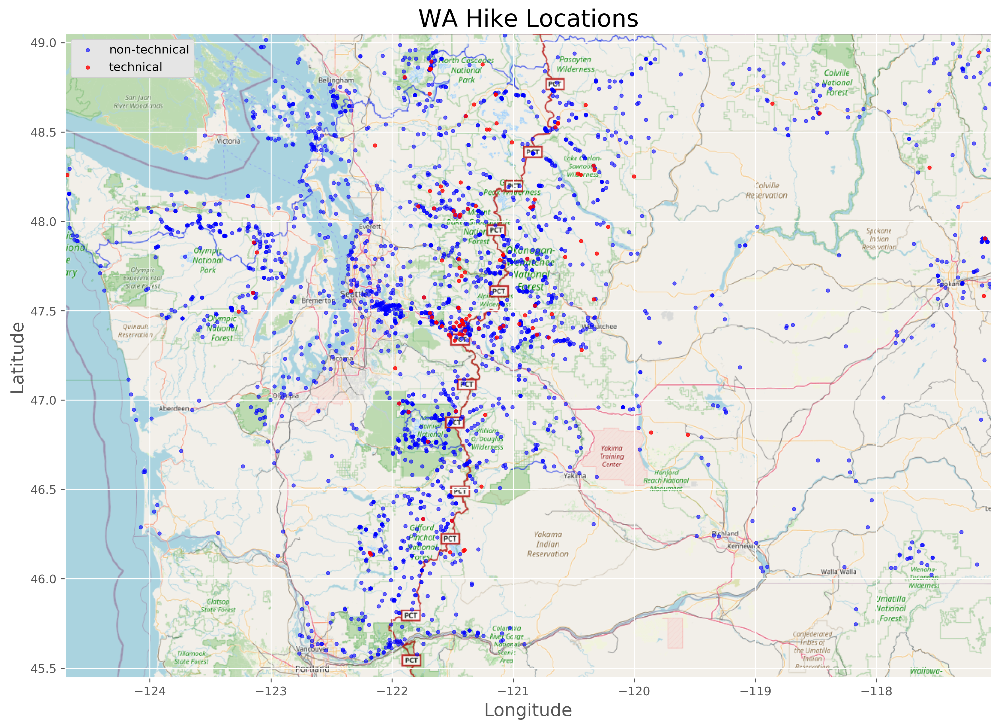

In [127]:
wa_map = plt.imread('../images/wa-map.png')
bound_box = [-124.7, -117.048, 45.445, 49.05]
latlon = hikes[['lat', 'lon', 'technical']].dropna()

fig, ax = plt.subplots(figsize = (14,10))
ax.scatter(
    latlon[latlon['technical'] == 0]['lon'].values, 
    latlon[latlon['technical'] == 0]['lat'].values, 
    alpha= 0.6, 
    c='b',
    zorder=1,
    marker='.')
ax.scatter(
    latlon[latlon['technical'] == 1]['lon'].values, 
    latlon[latlon['technical'] == 1]['lat'].values, 
    alpha= 0.8, 
    c='r',
    zorder=1,
    marker='.')
ax.set_xlim(bound_box[0],bound_box[1])
ax.set_ylim(bound_box[2],bound_box[3])
ax.set_xlabel('Longitude', fontsize=15)
ax.set_ylabel('Latitude', fontsize=15)
ax.set_title('WA Hike Locations', fontsize=20)
ax.imshow(wa_map, extent = bound_box, aspect='auto', zorder=0)
ax.legend(['non-technical','technical'], loc='upper left', framealpha=1)

fig.savefig('../images/wa_map_scatter.png', dpi=300, bbox_inches='tight')

In [86]:
bound_box = [-124.827, -117.048, 45.445, 48.995]
latlon = hikes[['lat','lon','drive time']].dropna()

fig = go.Figure()

fig.add_trace(
    go.Scatter(x=latlon['lon'].values, y=latlon['lat'].values, mode='markers')
)

fig.add_layout_image(
    dict(
        source='../images/wa-map.png',
        xref='x',
        yref='y',
        x=bound_box[0],
        y=bound_box[3],
        sizex=bound_box[1] - bound_box[0],
        sizey=bound_box[3] - bound_box[2],
        sizing='stretch',
        layer='below'
    )
)

fig.show()

In [112]:
hikes_scatter = hikes.iloc[:,[2,3,4,28,29,30,32,33]]
hikes_scatter = hikes_scatter[(hikes_scatter['length'] < 301) & (hikes_scatter['drive distance'] < 1000)]

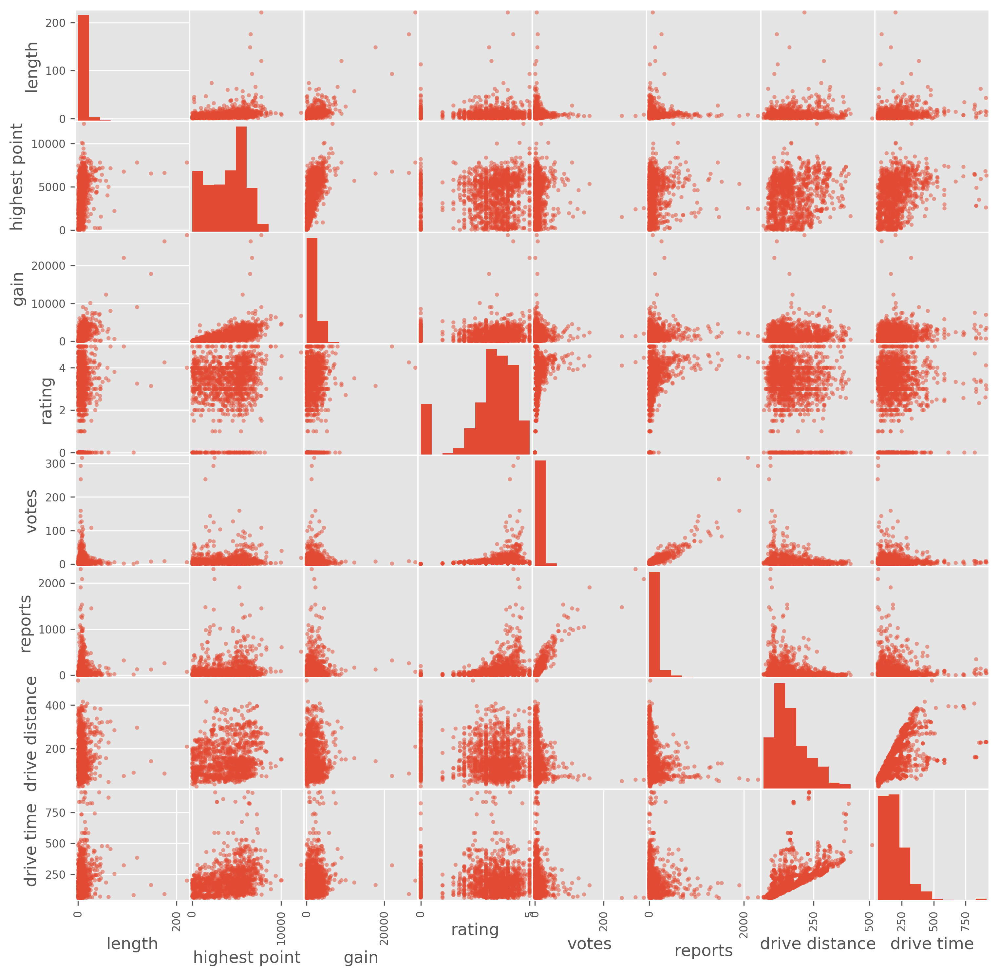

In [113]:
pd.plotting.scatter_matrix(hikes_scatter, figsize=(12,12));

In [118]:
hikes_scatter = hikes.iloc[:,[2,3,4,28,29,30,32,33, 10]]
hikes_scatter = hikes_scatter[(hikes_scatter['length'] < 301) & (hikes_scatter['drive distance'] < 1000)]

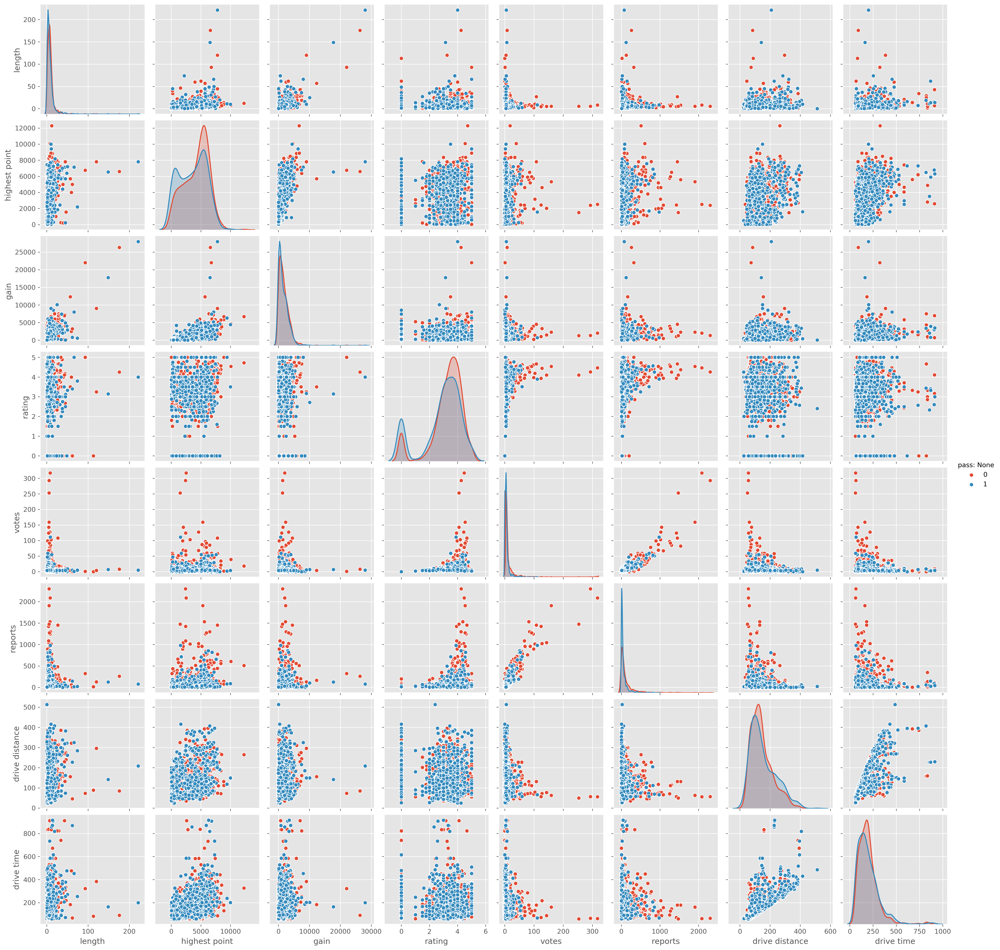

In [119]:
g = sns.pairplot(hikes_scatter, hue="pass: None")

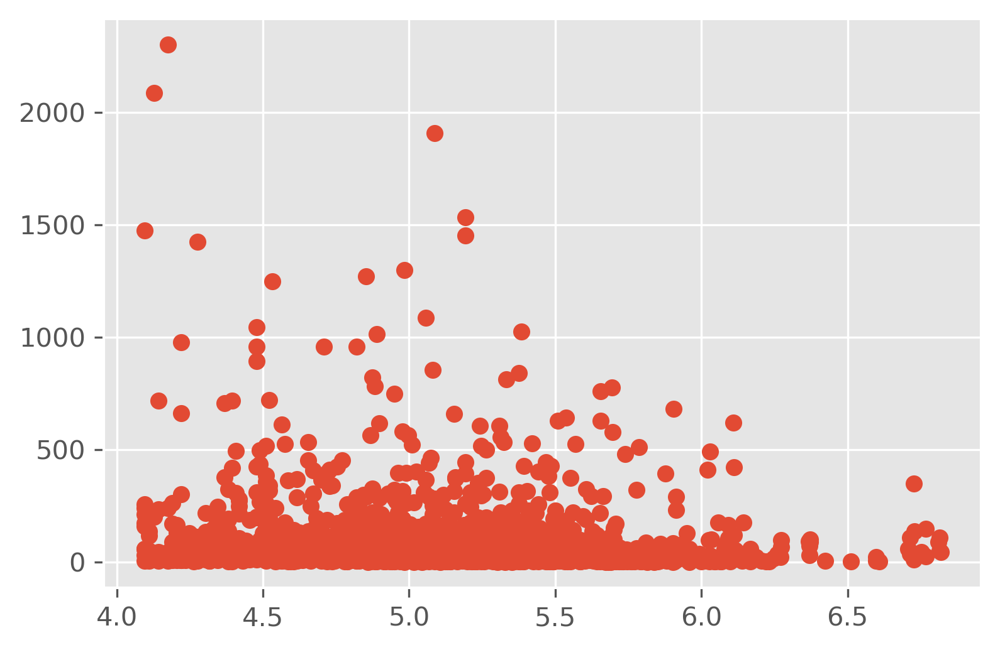

In [128]:
plt.scatter(np.log(hikes_scatter['drive time']), hikes_scatter['reports'])